# Image Data Collection and Processing
## Formative 2 - Data Preprocessing

This notebook processes facial images with multiple augmentations and extracts features for each team member.

Team Members:
1. Erneste
2. Thierry
3. Rodas
4. Idara

Required expressions: Neutral, Smile, Surprised

## What This Notebook Does:
1. Loads images from existing Images folder
2. Creates Augmented_Images and Visualizations folders inside Image_Processing
3. Loads and displays your facial images
4. Applies 15 augmentations per image
5. Creates comprehensive visualizations for all images and members
6. Saves everything to image_features.csv inside Image_Processing_Notebook

**Simply run all cells and the notebook will handle everything!**

## 1. Import Required Libraries

In [34]:
import os
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from datetime import datetime

# Configure matplotlib for inline display
%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 8)

print(" Libraries imported successfully!")

 Libraries imported successfully!


## 2. Configuration & Directory Setup

In [35]:
# Get the current directory (Image_Processing)
NOTEBOOK_DIR = Path.cwd()
ROOT_DIR = NOTEBOOK_DIR.parent  # Project root directory

print(f" Project Root Directory: {ROOT_DIR}")
print(f" Notebook Directory: {NOTEBOOK_DIR}\n")

# Configuration - Images from project root, outputs in notebook directory
IMAGES_DIR = NOTEBOOK_DIR / "Images"
OUTPUT_CSV = NOTEBOOK_DIR / "image_features.csv"
AUGMENTED_DIR = NOTEBOOK_DIR / "Augmented_Images"
VISUALIZATIONS_DIR = NOTEBOOK_DIR / "Visualizations"

# Team members and expressions
TEAM_MEMBERS = ["Erneste", "Thierry", "Rodas", "Idara"]
EXPRESSIONS = ["Neutral", "Smile", "Surprised"]

print("   Configuration:")
print(f"  • Images Directory: {IMAGES_DIR}")
print(f"  • Output CSV: {OUTPUT_CSV}")
print(f"  • Augmented Directory: {AUGMENTED_DIR}")
print(f"  • Visualizations Directory: {VISUALIZATIONS_DIR}")
print(f"  • Team Members: {', '.join(TEAM_MEMBERS)}")
print(f"  • Expressions: {', '.join(EXPRESSIONS)}")

 Project Root Directory: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing
 Notebook Directory: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing\Image_Processing

   Configuration:
  • Images Directory: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing\Image_Processing\Images
  • Output CSV: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing\Image_Processing\image_features.csv
  • Augmented Directory: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing\Image_Processing\Augmented_Images
  • Visualizations Directory: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing\Image_Processing\Visualizations
  • Team Members: Erneste, Thierry, Rodas, Idara
  • Expressions: Neutral, Smile, Surprised


## 3. Create Output Directories in Notebook Folder

In [36]:
# Create output directories inside notebook folder
AUGMENTED_DIR.mkdir(parents=True, exist_ok=True)
VISUALIZATIONS_DIR.mkdir(parents=True, exist_ok=True)

print("Directories created/verified:")
print(f"  • Images source: {IMAGES_DIR}")
print(f"  • Augmented output: {AUGMENTED_DIR}")
print(f"  • Visualizations: {VISUALIZATIONS_DIR}")

# Check if Images directory exists
if not IMAGES_DIR.exists():
    print(f"\nERROR: Images directory not found at {IMAGES_DIR}")
    print(f"   Please ensure the 'Images' folder exists at the project root with your images.")
else:
    print(f"\nImages directory found at project root!")
    print(f"\n   Image files should be in format: MemberName_Expression.jpg")
    print(f"   Example: Erneste_Neutral.jpg")

Directories created/verified:
  • Images source: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing\Image_Processing\Images
  • Augmented output: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing\Image_Processing\Augmented_Images
  • Visualizations: c:\Users\LENOVO\Desktop\Formative-2__Data-Preprocessing\Image_Processing\Visualizations

Images directory found at project root!

   Image files should be in format: MemberName_Expression.jpg
   Example: Erneste_Neutral.jpg


## 4. Check for Images

In [37]:
# Check which images exist
missing_images = []
existing_images = []

if IMAGES_DIR.exists():
    for member in TEAM_MEMBERS:
        for expression in EXPRESSIONS:
            filename = f"{member}_{expression}.jpg"
            filepath = IMAGES_DIR / filename
            
            if filepath.exists():
                existing_images.append((member, expression, filename))
            else:
                missing_images.append((member, expression, filename))
else:
    print(f"Images directory not found: {IMAGES_DIR}")

print(f"\n{'='*60}")
print("IMAGE INVENTORY")
print(f"{'='*60}")
print(f"Found: {len(existing_images)} images")
print(f"Missing: {len(missing_images)} images")

if existing_images:
    print(f"\nAvailable Images:")
    for member, expression, filename in existing_images:
        print(f"  • {filename}")

if missing_images:
    print(f"\nMissing Images:")
    for member, expression, filename in missing_images:
        print(f"  • {filename} ({member} - {expression})")

print(f"{'='*60}\n")

if not existing_images:
    print("No images found! Please add images to the Images folder at project root.")
else:
    print(f"Ready to process {len(existing_images)} images!")
    print(f"Expected total records with 15 augmentations: {len(existing_images) * 16}")  # Original + 15 augmentations


IMAGE INVENTORY
Found: 12 images
Missing: 0 images

Available Images:
  • Erneste_Neutral.jpg
  • Erneste_Smile.jpg
  • Erneste_Surprised.jpg
  • Thierry_Neutral.jpg
  • Thierry_Smile.jpg
  • Thierry_Surprised.jpg
  • Rodas_Neutral.jpg
  • Rodas_Smile.jpg
  • Rodas_Surprised.jpg
  • Idara_Neutral.jpg
  • Idara_Smile.jpg
  • Idara_Surprised.jpg

Ready to process 12 images!
Expected total records with 15 augmentations: 192


## 5. Load and Display Original Images

Loading and displaying images...

  Loaded: Erneste_Neutral.jpg - Shape: (3392, 2544, 3)
  Loaded: Erneste_Smile.jpg - Shape: (3392, 2544, 3)
  Loaded: Erneste_Surprised.jpg - Shape: (3392, 2544, 3)


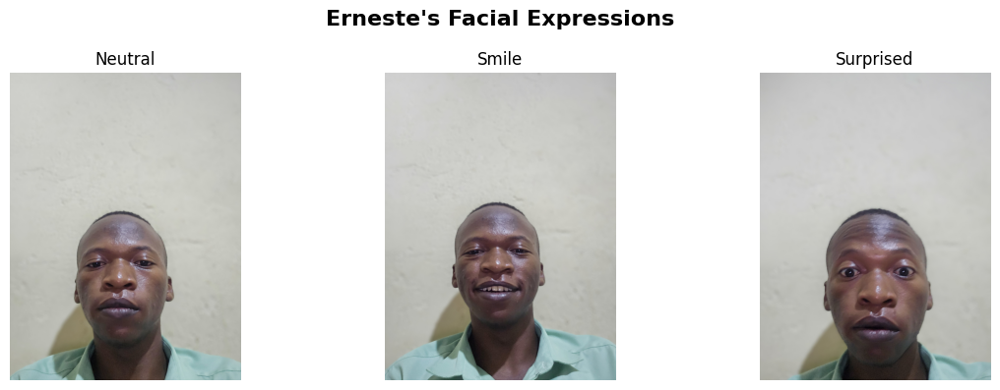

  Saved: Erneste_original_images.png

  Loaded: Thierry_Neutral.jpg - Shape: (1080, 810, 3)
  Loaded: Thierry_Smile.jpg - Shape: (1280, 720, 3)
  Loaded: Thierry_Surprised.jpg - Shape: (1280, 720, 3)


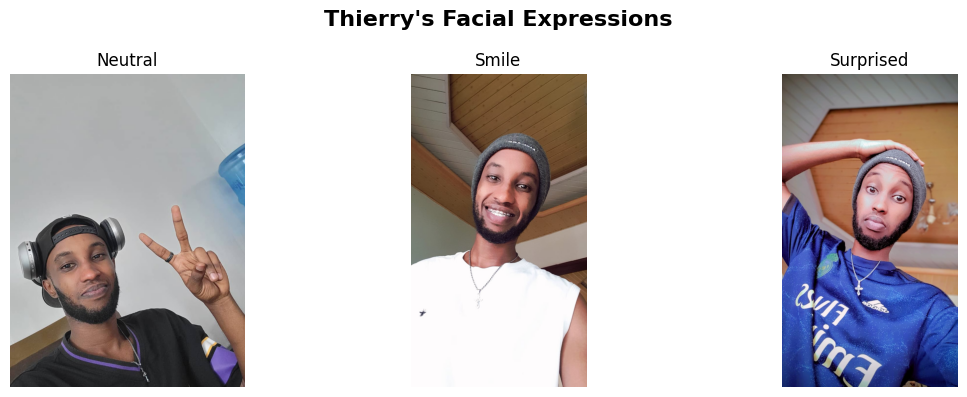

  Saved: Thierry_original_images.png

  Loaded: Rodas_Neutral.jpg - Shape: (1280, 720, 3)
  Loaded: Rodas_Smile.jpg - Shape: (1280, 720, 3)
  Loaded: Rodas_Surprised.jpg - Shape: (1280, 720, 3)


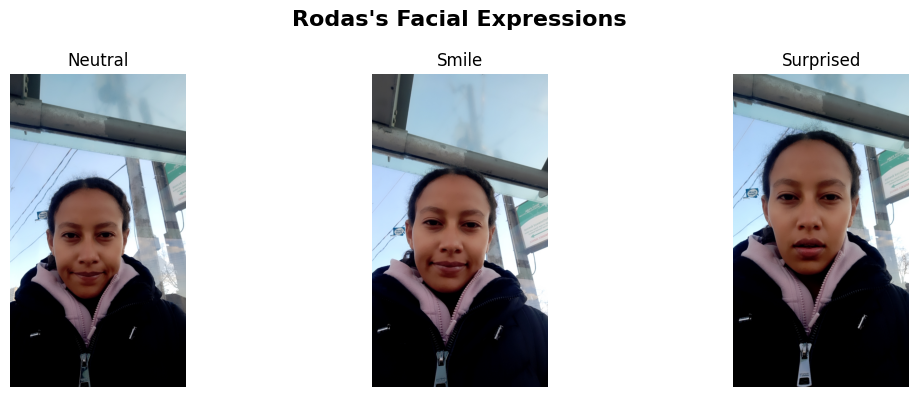

  Saved: Rodas_original_images.png

  Loaded: Idara_Neutral.jpg - Shape: (1920, 1080, 3)
  Loaded: Idara_Smile.jpg - Shape: (1920, 1080, 3)
  Loaded: Idara_Surprised.jpg - Shape: (1920, 1080, 3)


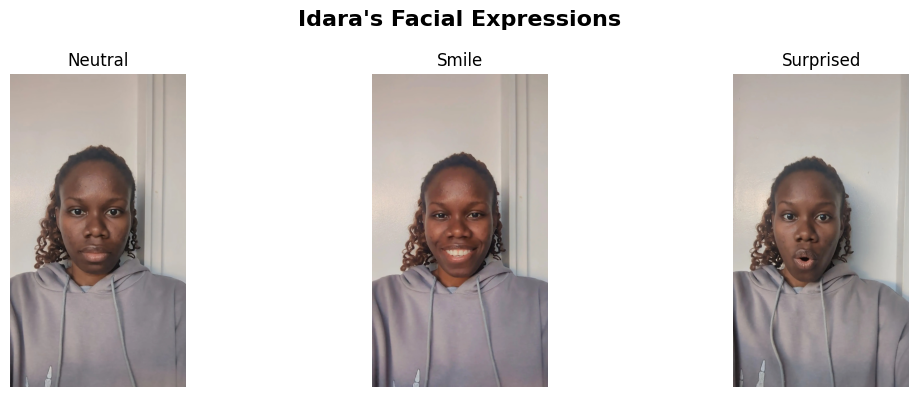

  Saved: Idara_original_images.png



In [38]:
if existing_images:
    print("Loading and displaying images...\n")
    
    # Group by member
    member_images = {}
    for member, expression, filename in existing_images:
        if member not in member_images:
            member_images[member] = []
        member_images[member].append((expression, filename))
    
    # Display images for each member
    for member, images in member_images.items():
        num_images = len(images)
        if num_images == 0:
            continue
            
        fig, axes = plt.subplots(1, num_images, figsize=(4*num_images, 4))
        if num_images == 1:
            axes = [axes]
        
        fig.suptitle(f"{member}'s Facial Expressions", fontsize=16, fontweight='bold')
        
        for idx, (expression, filename) in enumerate(images):
            filepath = IMAGES_DIR / filename
            img = cv2.imread(str(filepath))
            
            if img is not None:
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                axes[idx].imshow(img_rgb)
                axes[idx].set_title(expression, fontsize=12)
                axes[idx].axis('off')
                print(f"  Loaded: {filename} - Shape: {img.shape}")
            else:
                print(f"  Failed to load: {filename}")
        
        plt.tight_layout()
        # Save in Visualizations folder
        save_path = VISUALIZATIONS_DIR / f"{member}_original_images.png"
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        plt.show()
        print(f"  Saved: {save_path.name}\n")
else:
    print("No images to display!")

## 6. Define Augmentation Functions (INCREASED TO 15 AUGMENTATIONS)

In [39]:
def apply_augmentations(image, base_filename):
    """
    Apply 15 different augmentations to an image
    Returns: list of (augmented_image, augmentation_name, filename) tuples
    """
    augmented = []
    height, width = image.shape[:2]
    
    # 1. Rotation (15 degrees clockwise)
    center = (width // 2, height // 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, 15, 1.0)
    rotated = cv2.warpAffine(image, rotation_matrix, (width, height))
    augmented.append((rotated, "Rotation_15deg", f"{base_filename}_rotated.jpg"))
    
    # 2. Horizontal Flip
    flipped = cv2.flip(image, 1)
    augmented.append((flipped, "Horizontal_Flip", f"{base_filename}_flipped.jpg"))
    
    # 3. Grayscale
    if len(image.shape) == 3:
        grayscale = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        grayscale_3ch = cv2.cvtColor(grayscale, cv2.COLOR_GRAY2BGR)
    else:
        grayscale_3ch = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
    augmented.append((grayscale_3ch, "Grayscale", f"{base_filename}_grayscale.jpg"))
    
    # 4. Brightness Adjustment (increase by 30)
    bright = cv2.convertScaleAbs(image, alpha=1.0, beta=30)
    augmented.append((bright, "Brightness_+30", f"{base_filename}_bright.jpg"))
    
    # 5. Zoom (1.2x crop from center)
    crop_size = int(min(height, width) * 0.8)
    start_y = (height - crop_size) // 2
    start_x = (width - crop_size) // 2
    cropped = image[start_y:start_y+crop_size, start_x:start_x+crop_size]
    zoomed = cv2.resize(cropped, (width, height))
    augmented.append((zoomed, "Zoom_1.2x", f"{base_filename}_zoomed.jpg"))
    
    # 6. Rotation (-15 degrees counter-clockwise)
    rotation_matrix_neg = cv2.getRotationMatrix2D(center, -15, 1.0)
    rotated_neg = cv2.warpAffine(image, rotation_matrix_neg, (width, height))
    augmented.append((rotated_neg, "Rotation_-15deg", f"{base_filename}_rotated_neg.jpg"))
    
    # 7. Brightness Adjustment (decrease by 20)
    dark = cv2.convertScaleAbs(image, alpha=1.0, beta=-20)
    augmented.append((dark, "Brightness_-20", f"{base_filename}_dark.jpg"))
    
    # 8. Contrast Adjustment (increase contrast)
    contrast = cv2.convertScaleAbs(image, alpha=1.5, beta=0)
    augmented.append((contrast, "Contrast_1.5x", f"{base_filename}_contrast.jpg"))
    
    # 9. Gaussian Blur
    blurred = cv2.GaussianBlur(image, (5, 5), 0)
    augmented.append((blurred, "Gaussian_Blur", f"{base_filename}_blurred.jpg"))
    
    # 10. Vertical Flip
    vflipped = cv2.flip(image, 0)
    augmented.append((vflipped, "Vertical_Flip", f"{base_filename}_vflipped.jpg"))
    
    # 11. Rotation (10 degrees clockwise)
    rotation_matrix_10 = cv2.getRotationMatrix2D(center, 10, 1.0)
    rotated_10 = cv2.warpAffine(image, rotation_matrix_10, (width, height))
    augmented.append((rotated_10, "Rotation_10deg", f"{base_filename}_rotated_10.jpg"))
    
    # 12. Brightness Adjustment (increase by 15)
    bright_15 = cv2.convertScaleAbs(image, alpha=1.0, beta=15)
    augmented.append((bright_15, "Brightness_+15", f"{base_filename}_bright_15.jpg"))
    
    # 13. Contrast Adjustment (decrease contrast)
    contrast_low = cv2.convertScaleAbs(image, alpha=0.7, beta=0)
    augmented.append((contrast_low, "Contrast_0.7x", f"{base_filename}_contrast_low.jpg"))
    
    # 14. Median Blur
    median_blurred = cv2.medianBlur(image, 5)
    augmented.append((median_blurred, "Median_Blur", f"{base_filename}_median_blur.jpg"))
    
    # 15. Zoom (1.1x crop from center)
    crop_size_11 = int(min(height, width) * 0.9)
    start_y_11 = (height - crop_size_11) // 2
    start_x_11 = (width - crop_size_11) // 2
    cropped_11 = image[start_y_11:start_y_11+crop_size_11, start_x_11:start_x_11+crop_size_11]
    zoomed_11 = cv2.resize(cropped_11, (width, height))
    augmented.append((zoomed_11, "Zoom_1.1x", f"{base_filename}_zoomed_11.jpg"))
    
    return augmented

print("Augmentation functions defined")
print("  Augmentations (15 total): Rotation (15°, -15°, 10°), Horizontal/Vertical Flip, Grayscale,")
print("  Brightness (±), Contrast (1.5x, 0.7x), Gaussian/Median Blur, Zoom (1.2x, 1.1x)")

Augmentation functions defined
  Augmentations (15 total): Rotation (15°, -15°, 10°), Horizontal/Vertical Flip, Grayscale,
  Brightness (±), Contrast (1.5x, 0.7x), Gaussian/Median Blur, Zoom (1.2x, 1.1x)


## 7. Define Feature Extraction Function

In [40]:
def extract_features(image, member, expression, augmentation):
    """
    Extract multiple features from an image:
    - Color histogram features (RGB channels - 24 features)
    - Grayscale histogram features (8 features)
    - Statistical features (mean, std, min, max, median - 5 features)
    - Texture features (edge density - 1 feature)
    """
    features = {
        'member': member,
        'expression': expression,
        'augmentation': augmentation,
        'timestamp': datetime.now().strftime("%Y-%m-%d %H:%M:%S")
    }
    
    # Image dimensions
    features['height'] = image.shape[0]
    features['width'] = image.shape[1]
    features['channels'] = image.shape[2] if len(image.shape) == 3 else 1
    
    # Convert to RGB for consistent processing
    if len(image.shape) == 3:
        img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    else:
        img_rgb = image
    
    # Color histogram features (8 bins per channel)
    if len(image.shape) == 3:
        for i, color in enumerate(['R', 'G', 'B']):
            hist = cv2.calcHist([img_rgb], [i], None, [8], [0, 256])
            hist = hist.flatten() / hist.sum()  # Normalize
            for j, val in enumerate(hist):
                features[f'hist_{color}_{j}'] = val
    
    # Grayscale histogram features
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray = image
    
    hist_gray = cv2.calcHist([gray], [0], None, [8], [0, 256])
    hist_gray = hist_gray.flatten() / hist_gray.sum()
    for j, val in enumerate(hist_gray):
        features[f'hist_gray_{j}'] = val
    
    # Statistical features
    features['mean_intensity'] = np.mean(gray)
    features['std_intensity'] = np.std(gray)
    features['min_intensity'] = np.min(gray)
    features['max_intensity'] = np.max(gray)
    features['median_intensity'] = np.median(gray)
    
    # Texture features (edge density)
    edges = cv2.Canny(gray, 100, 200)
    features['edge_density'] = np.sum(edges > 0) / (gray.shape[0] * gray.shape[1])
    
    return features

print("Feature extraction function defined")

Feature extraction function defined


## 8. Process All Images - Main Execution

In [41]:
if not existing_images:
    print("ERROR: No images found to process!")
    print("Please add images to the 'Images/' directory at project root and rerun this cell.")
else:
    print(f"\n{'='*60}")
    print("STARTING IMAGE PROCESSING")
    print(f"{'='*60}\n")
    
    # Process each image
    all_features = []
    
    for member, expression, filename in existing_images:
        print(f"Processing: {filename}")
        filepath = IMAGES_DIR / filename
        image = cv2.imread(str(filepath))
        
        if image is None:
            print(f"  Failed to load {filename}")
            continue
        
        # Extract features from original image
        base_name = filename.rsplit('.', 1)[0]
        features_original = extract_features(image, member, expression, "Original")
        all_features.append(features_original)
        print(f"  Extracted features from original")
        
        # Apply augmentations
        augmented_list = apply_augmentations(image, base_name)
        print(f"  Applied {len(augmented_list)} augmentations")
        
        # Save augmented images and extract features
        for aug_img, aug_name, aug_filename in augmented_list:
            # Save augmented image
            aug_path = AUGMENTED_DIR / aug_filename
            cv2.imwrite(str(aug_path), aug_img)
            
            # Extract features
            features_aug = extract_features(aug_img, member, expression, aug_name)
            all_features.append(features_aug)
        
        print(f"  Saved augmented images to '{AUGMENTED_DIR.name}/'")
        print(f"  Total feature sets: {len(augmented_list) + 1} (1 original + {len(augmented_list)} augmented)\n")
    
    # Save features to CSV
    df_features = pd.DataFrame(all_features)
    df_features.to_csv(str(OUTPUT_CSV), index=False)
    
    print(f"\n{'='*60}")
    print("PROCESSING COMPLETE")
    print(f"{'='*60}")
    print(f"Total images processed: {len(existing_images)}")
    print(f"Total feature sets extracted: {len(all_features)}")
    print(f"Features saved to: {OUTPUT_CSV.name}")
    print(f"Augmented images saved to: {AUGMENTED_DIR.name}/")
    print(f"\nFeature CSV contains {len(df_features.columns)} columns")
    
    # Calculate expected total
    expected_total = len(existing_images) * 16  # Original + 15 augmentations
    print(f"\nExpected records with 15 augmentations: {expected_total}")
    print(f"Actual records generated: {len(all_features)}")
    
    print(f"{'='*60}\n")


STARTING IMAGE PROCESSING

Processing: Erneste_Neutral.jpg
  Extracted features from original
  Applied 15 augmentations
  Saved augmented images to 'Augmented_Images/'
  Total feature sets: 16 (1 original + 15 augmented)

Processing: Erneste_Smile.jpg
  Extracted features from original
  Applied 15 augmentations
  Saved augmented images to 'Augmented_Images/'
  Total feature sets: 16 (1 original + 15 augmented)

Processing: Erneste_Surprised.jpg
  Extracted features from original
  Applied 15 augmentations
  Saved augmented images to 'Augmented_Images/'
  Total feature sets: 16 (1 original + 15 augmented)

Processing: Thierry_Neutral.jpg
  Extracted features from original
  Applied 15 augmentations
  Saved augmented images to 'Augmented_Images/'
  Total feature sets: 16 (1 original + 15 augmented)

Processing: Thierry_Smile.jpg
  Extracted features from original
  Applied 15 augmentations
  Saved augmented images to 'Augmented_Images/'
  Total feature sets: 16 (1 original + 15 augmen

## 9. Create Augmentation Visualizations for All Members (UPDATED FOR 15 AUGMENTATIONS)

Creating augmentation visualizations for all members...

Creating augmentation visualization for: Erneste_Neutral.jpg


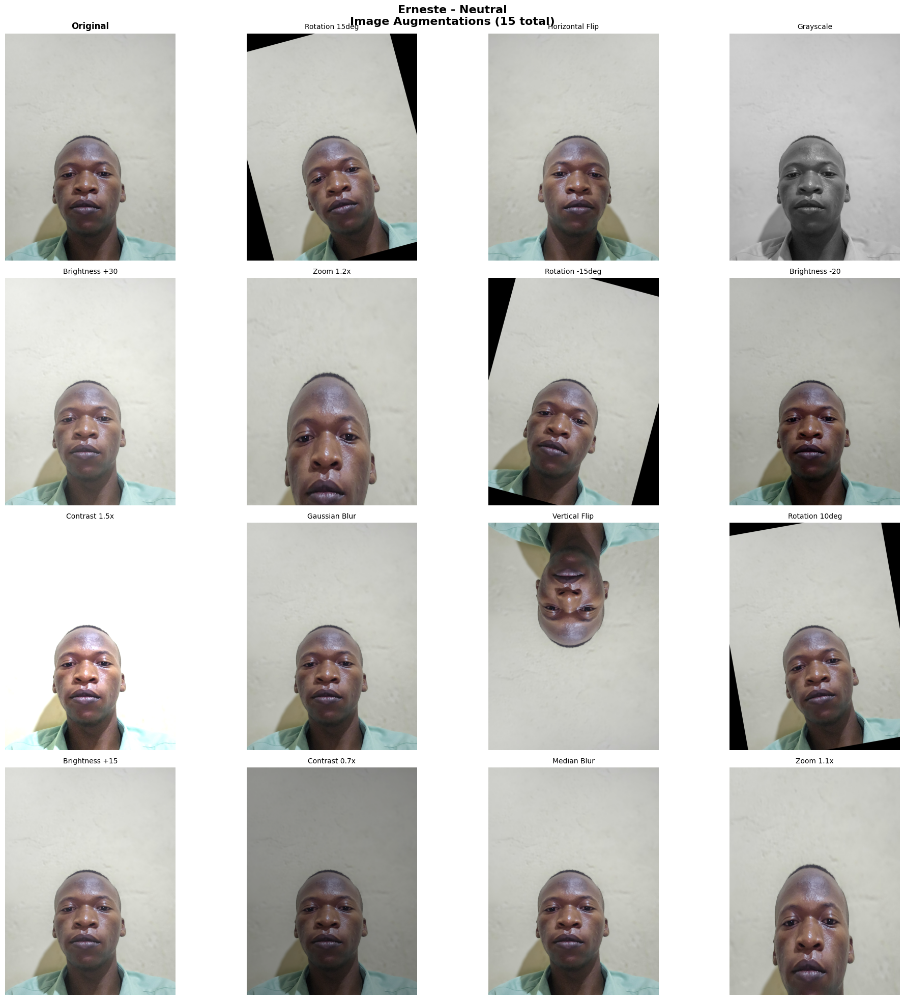

  Saved: Erneste_Neutral_augmentations.png
Creating augmentation visualization for: Erneste_Smile.jpg


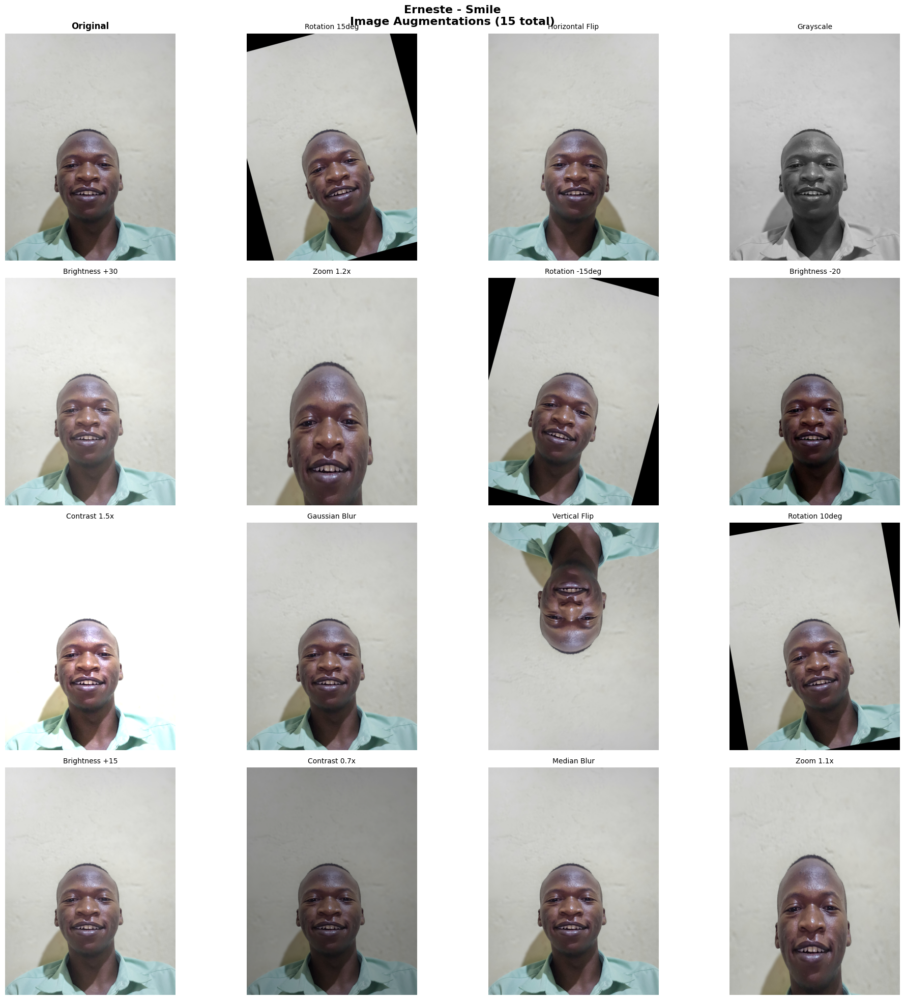

  Saved: Erneste_Smile_augmentations.png
Creating augmentation visualization for: Erneste_Surprised.jpg


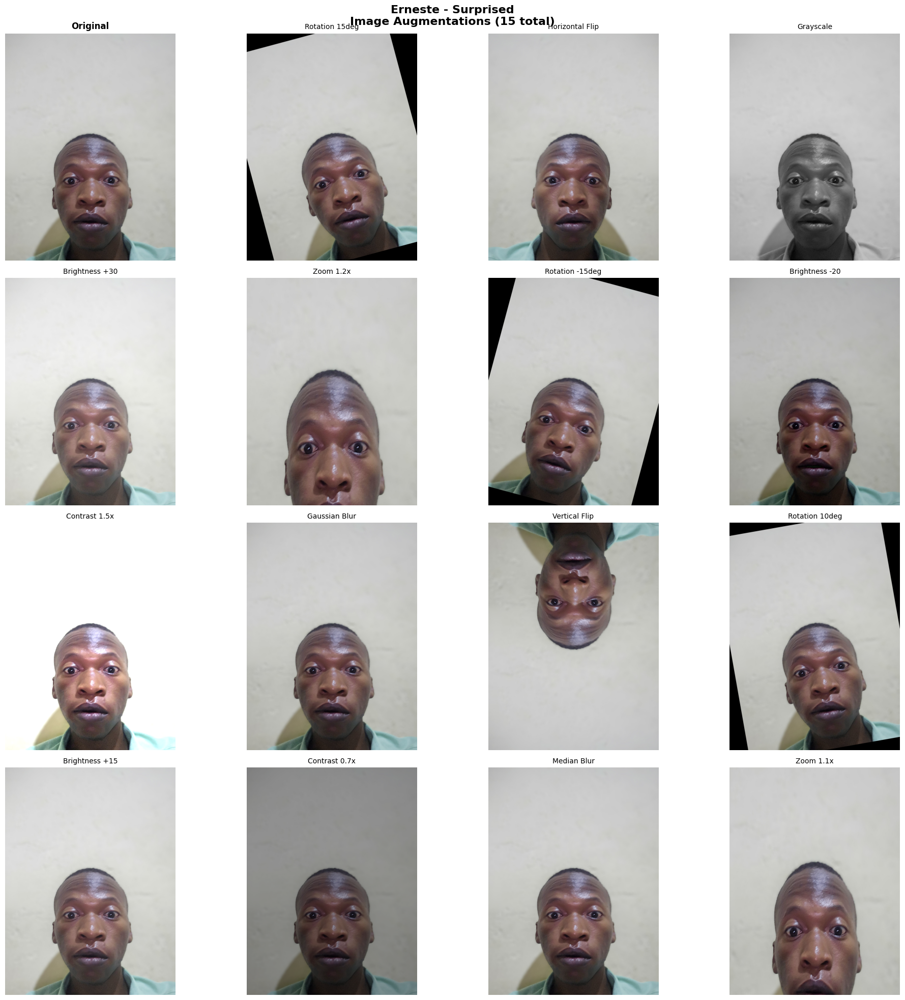

  Saved: Erneste_Surprised_augmentations.png
Creating augmentation visualization for: Thierry_Neutral.jpg


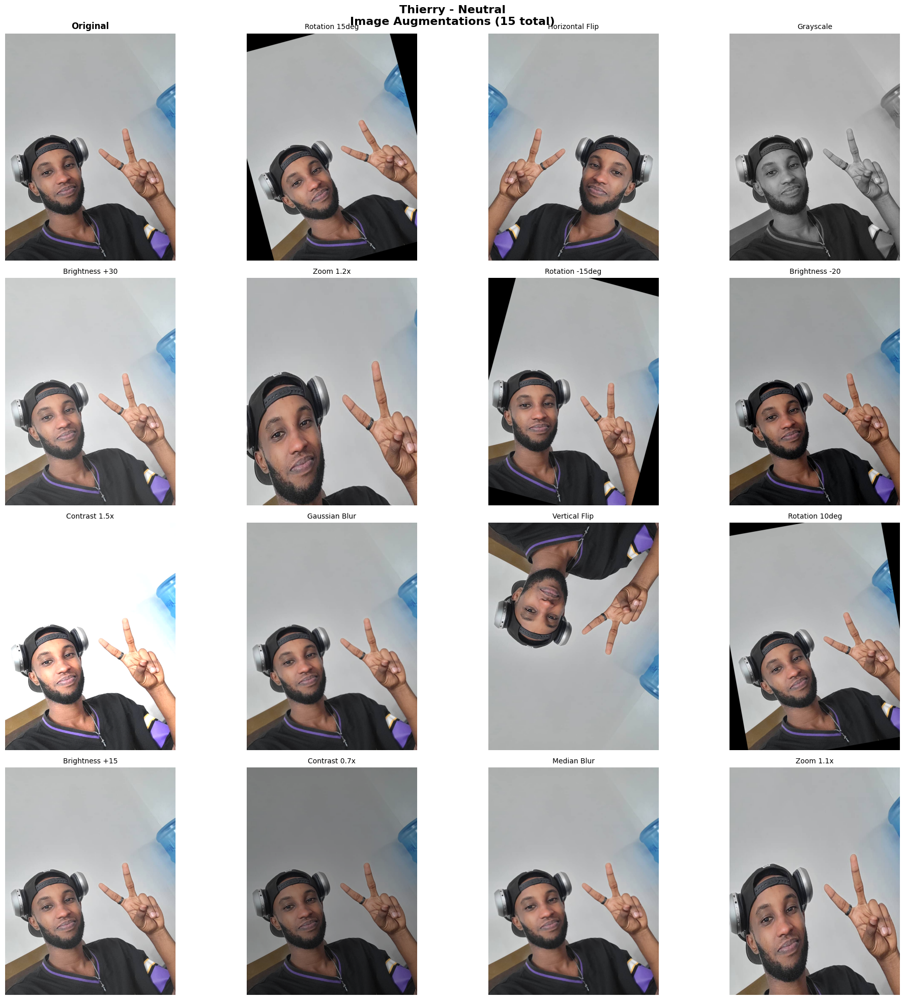

  Saved: Thierry_Neutral_augmentations.png
Creating augmentation visualization for: Thierry_Smile.jpg


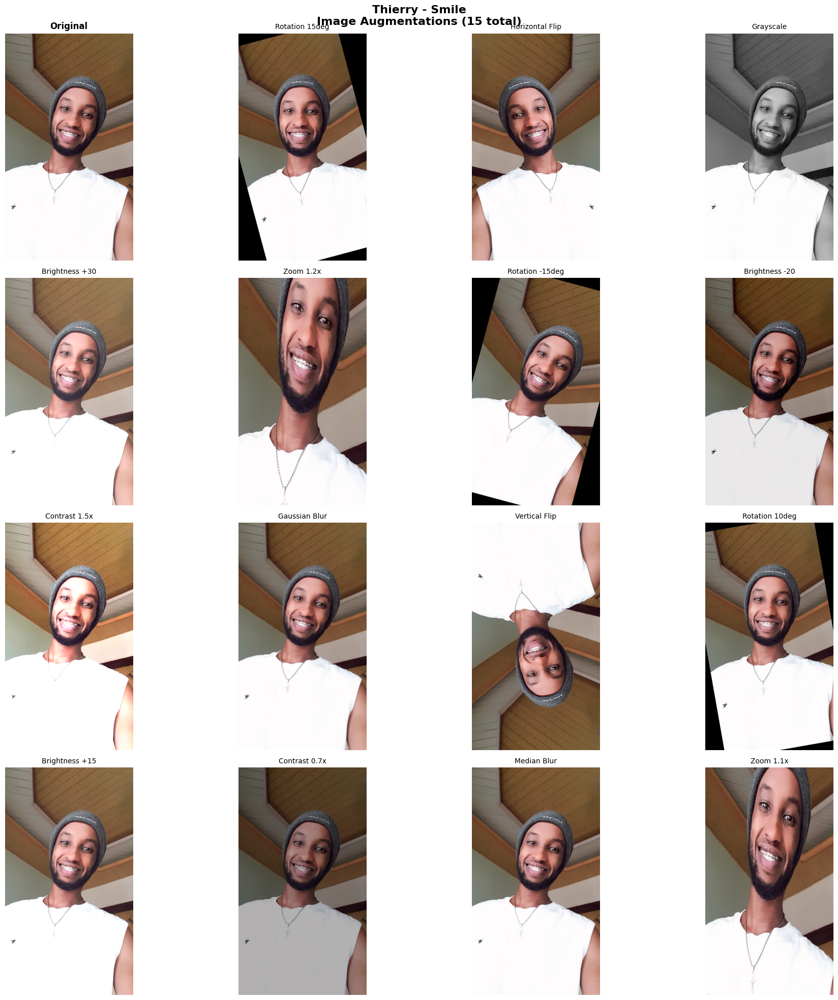

  Saved: Thierry_Smile_augmentations.png
Creating augmentation visualization for: Thierry_Surprised.jpg


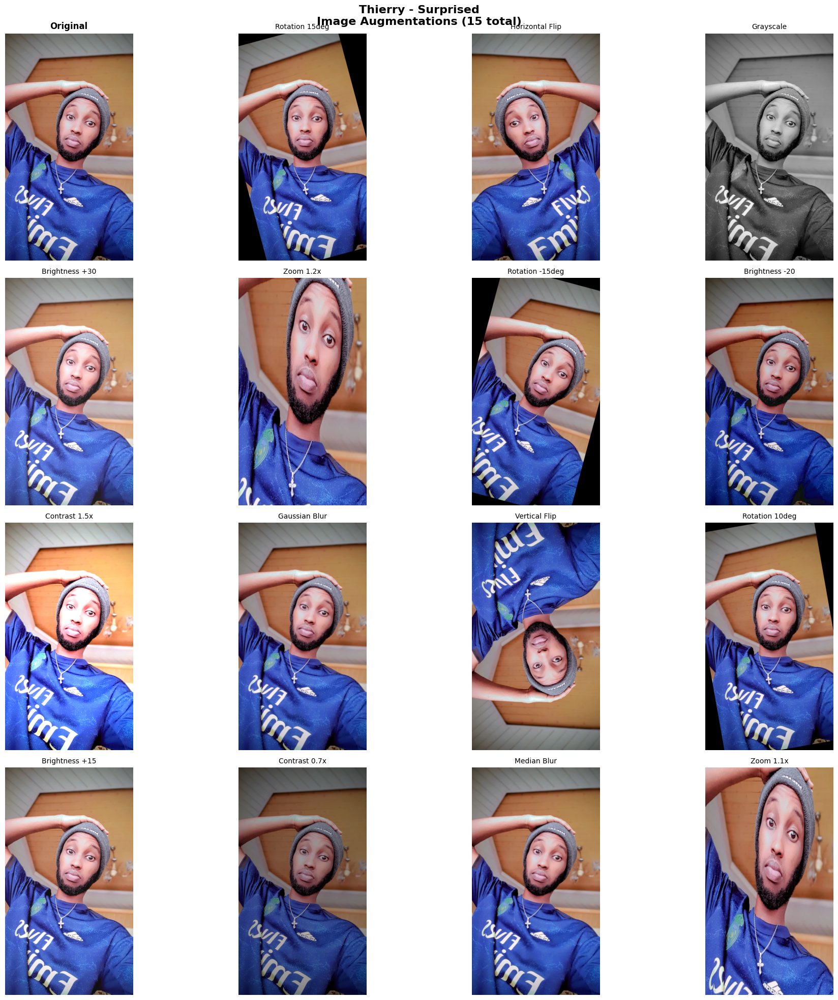

  Saved: Thierry_Surprised_augmentations.png
Creating augmentation visualization for: Rodas_Neutral.jpg


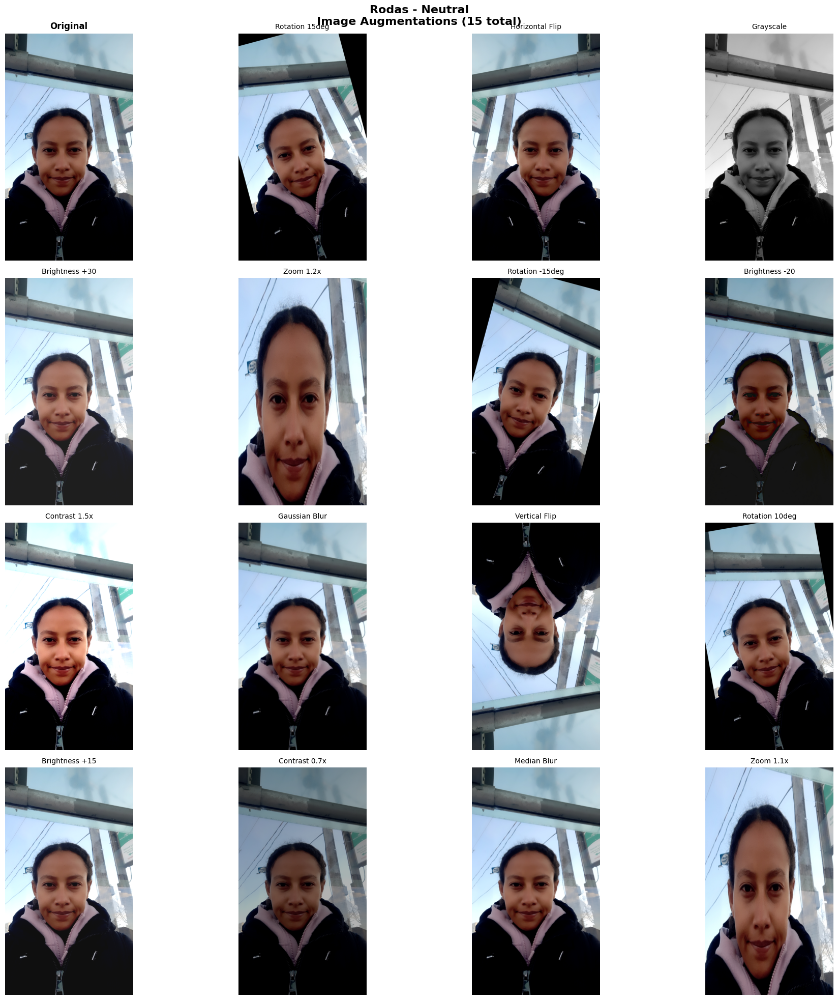

  Saved: Rodas_Neutral_augmentations.png
Creating augmentation visualization for: Rodas_Smile.jpg


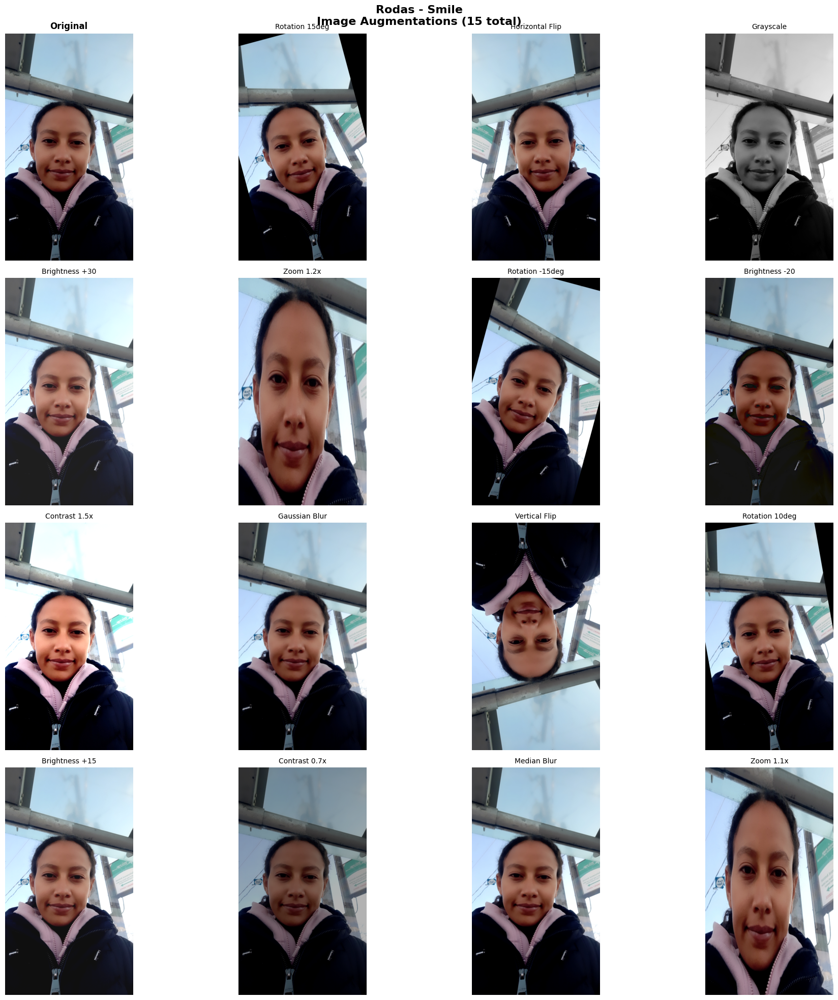

  Saved: Rodas_Smile_augmentations.png
Creating augmentation visualization for: Rodas_Surprised.jpg


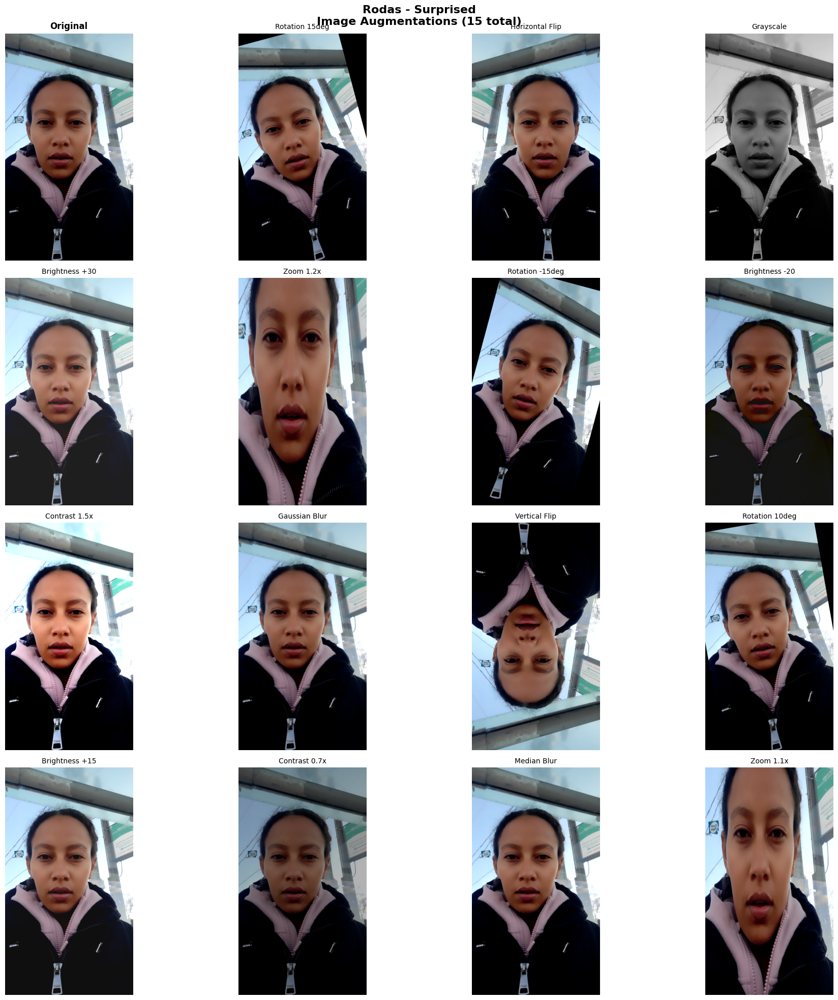

  Saved: Rodas_Surprised_augmentations.png
Creating augmentation visualization for: Idara_Neutral.jpg


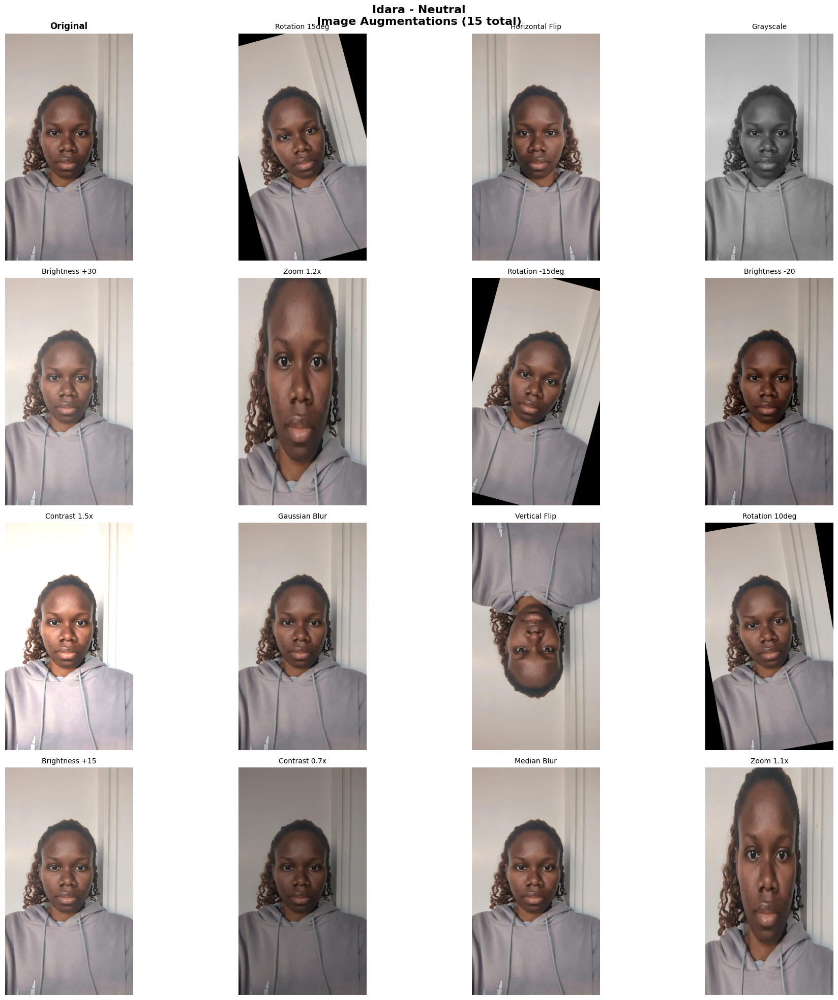

  Saved: Idara_Neutral_augmentations.png
Creating augmentation visualization for: Idara_Smile.jpg


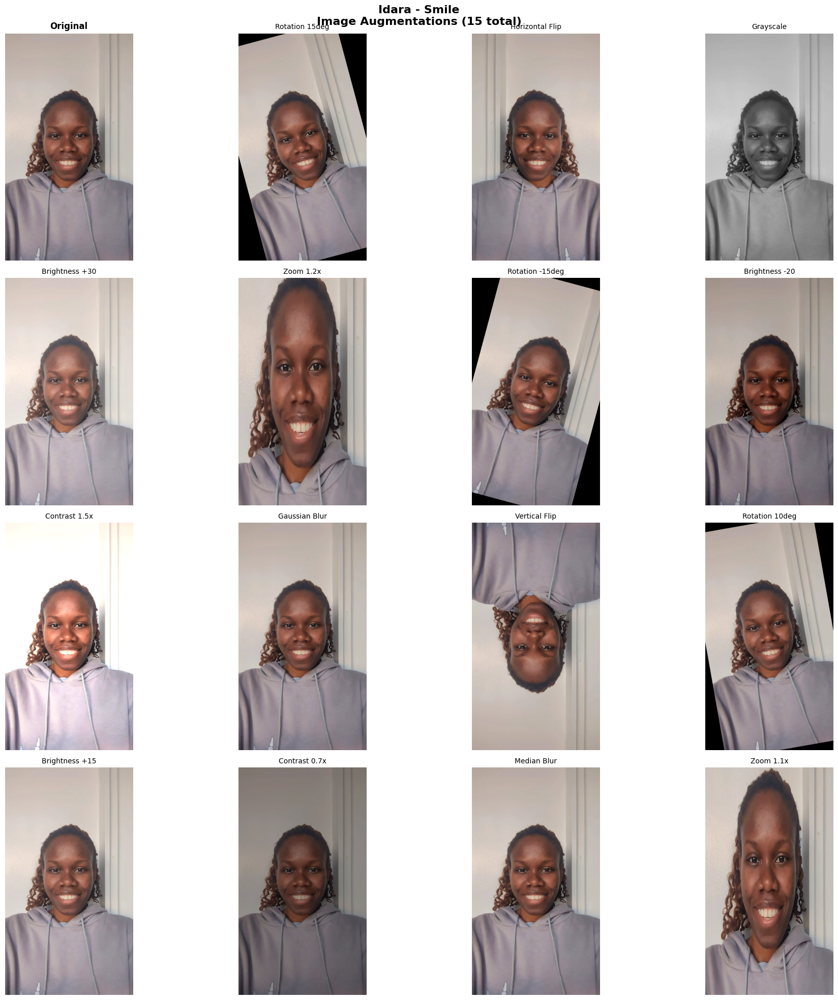

  Saved: Idara_Smile_augmentations.png
Creating augmentation visualization for: Idara_Surprised.jpg


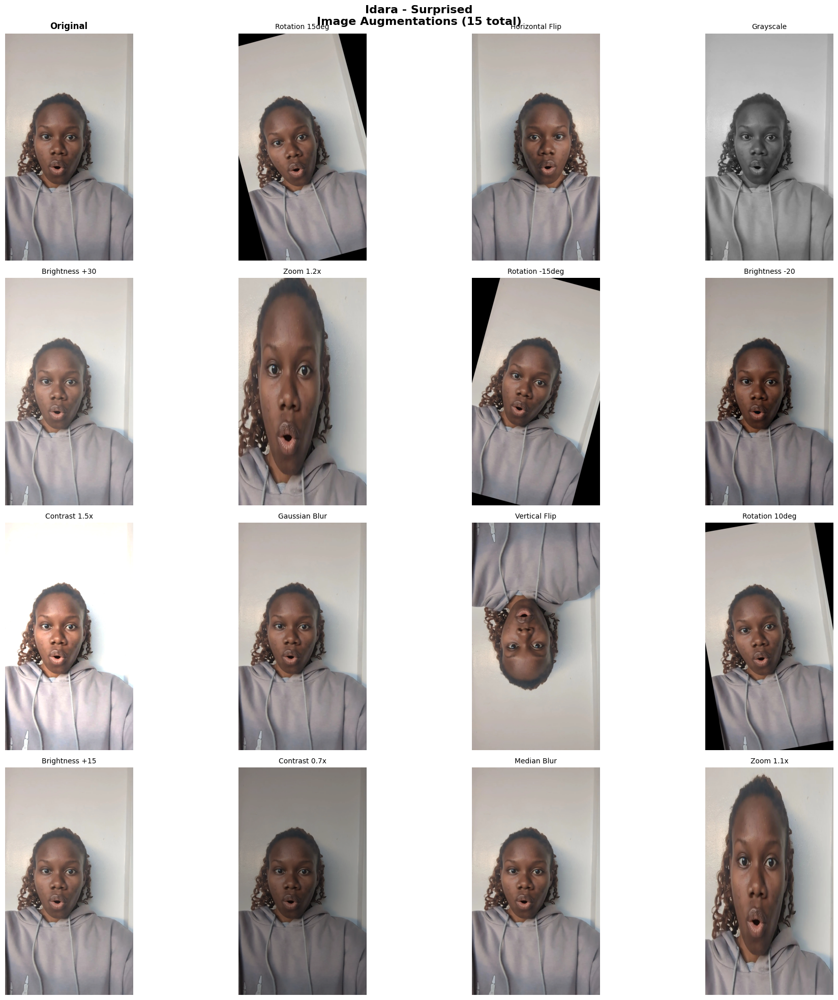

  Saved: Idara_Surprised_augmentations.png

Creating combined visualization for all members...


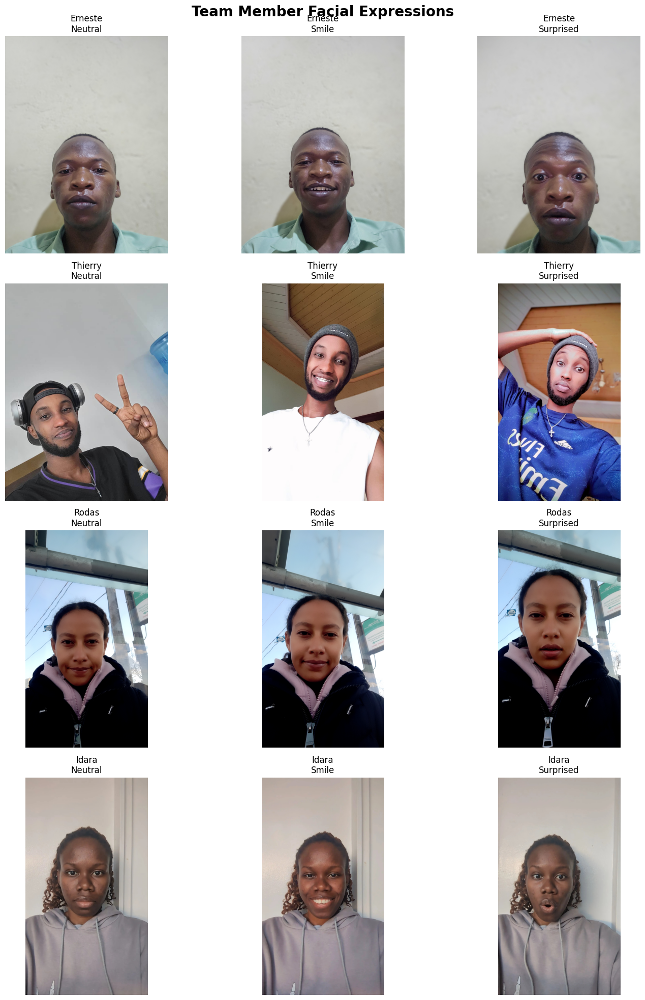

  Saved combined visualization: all_members_combined.png


In [42]:
def create_augmentation_visualizations_for_all():
    """Create augmentation visualizations for all images and each member"""
    if not existing_images:
        print("No images available for augmentation visualization")
        return
    
    print("Creating augmentation visualizations for all members...\n")
    
    # Create visualizations for each image
    for member, expression, filename in existing_images:
        print(f"Creating augmentation visualization for: {filename}")
        
        filepath = IMAGES_DIR / filename
        original_img = cv2.imread(str(filepath))
        
        if original_img is not None:
            base_name = filename.rsplit('.', 1)[0]
            augmented_list = apply_augmentations(original_img, base_name)
            
            # Display original and all augmentations in a 4x4 grid
            fig, axes = plt.subplots(4, 4, figsize=(20, 20))
            fig.suptitle(f'{member} - {expression}\nImage Augmentations (15 total)', fontsize=16, fontweight='bold')
            
            # Original image
            img_rgb = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB)
            axes[0, 0].imshow(img_rgb)
            axes[0, 0].set_title('Original', fontsize=12, fontweight='bold')
            axes[0, 0].axis('off')
            
            # Augmented images
            positions = [(0, 1), (0, 2), (0, 3), (1, 0), (1, 1), (1, 2), (1, 3), 
                        (2, 0), (2, 1), (2, 2), (2, 3), (3, 0), (3, 1), (3, 2), (3, 3)]
            for idx, ((aug_img, aug_name, _), (row, col)) in enumerate(zip(augmented_list, positions)):
                aug_rgb = cv2.cvtColor(aug_img, cv2.COLOR_BGR2RGB)
                axes[row, col].imshow(aug_rgb)
                axes[row, col].set_title(aug_name.replace('_', ' '), fontsize=10)
                axes[row, col].axis('off')
            
            plt.tight_layout()
            
            # Save in Visualizations folder
            save_path = VISUALIZATIONS_DIR / f"{member}_{expression}_augmentations.png"
            plt.savefig(save_path, dpi=150, bbox_inches='tight')
            plt.show()
            
            print(f"  Saved: {save_path.name}")
        else:
            print(f"  Could not load {filename}")
    
    # Create a combined visualization showing all members
    print("\nCreating combined visualization for all members...")
    create_combined_member_visualization()

def create_combined_member_visualization():
    """Create a combined visualization showing all team members' images"""
    if len(existing_images) < 2:
        print("  Not enough images for combined visualization")
        return
    
    try:
        # Group images by member
        member_images = {}
        for member, expression, filename in existing_images:
            if member not in member_images:
                member_images[member] = []
            member_images[member].append((expression, filename))
        
        # Create a grid of visualizations
        num_members = len(member_images)
        max_images_per_member = max(len(images) for images in member_images.values())
        
        fig, axes = plt.subplots(num_members, max_images_per_member, figsize=(5*max_images_per_member, 5*num_members))
        fig.suptitle('Team Member Facial Expressions', fontsize=20, fontweight='bold')
        
        # Handle single row case
        if num_members == 1:
            axes = axes.reshape(1, -1)
        
        for row_idx, (member, images) in enumerate(member_images.items()):
            for col_idx, (expression, filename) in enumerate(images):
                filepath = IMAGES_DIR / filename
                img = cv2.imread(str(filepath))
                
                if img is not None:
                    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    axes[row_idx, col_idx].imshow(img_rgb)
                    axes[row_idx, col_idx].set_title(f'{member}\n{expression}', fontsize=12)
                    axes[row_idx, col_idx].axis('off')
                else:
                    axes[row_idx, col_idx].set_title(f'{member}\nError loading', color='red')
                    axes[row_idx, col_idx].axis('off')
            
            # Hide empty subplots
            for col_idx in range(len(images), max_images_per_member):
                axes[row_idx, col_idx].set_visible(False)
        
        plt.tight_layout()
        
        # Save combined visualization
        save_path = VISUALIZATIONS_DIR / "all_members_combined.png"
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        plt.show()
        
        print(f"  Saved combined visualization: {save_path.name}")
        
    except Exception as e:
        print(f"  Error creating combined visualization: {str(e)}")

# Run the augmentation visualizations
create_augmentation_visualizations_for_all()

## 10. Display Summary Statistics

In [43]:
if existing_images and 'df_features' in locals():
    print("\n" + "="*60)
    print("SUMMARY STATISTICS")
    print("="*60)
    
    print("\nFeatures by Team Member:")
    member_counts = df_features.groupby('member').size()
    print(member_counts)
    
    print("\nFeatures by Expression:")
    expression_counts = df_features.groupby('expression').size()
    print(expression_counts)
    
    print("\nFeatures by Augmentation Type:")
    augmentation_counts = df_features.groupby('augmentation').size()
    print(augmentation_counts)
    
    print(f"\nTotal Records: {len(df_features)}")
    print(f"Expected with 15 augmentations: {len(existing_images) * 16}")
    
    print("\n" + "="*60)
else:
    print("No features to display - processing was not completed")


SUMMARY STATISTICS

Features by Team Member:
member
Erneste    48
Idara      48
Rodas      48
Thierry    48
dtype: int64

Features by Expression:
expression
Neutral      64
Smile        64
Surprised    64
dtype: int64

Features by Augmentation Type:
augmentation
Brightness_+15     12
Brightness_+30     12
Brightness_-20     12
Contrast_0.7x      12
Contrast_1.5x      12
Gaussian_Blur      12
Grayscale          12
Horizontal_Flip    12
Median_Blur        12
Original           12
Rotation_-15deg    12
Rotation_10deg     12
Rotation_15deg     12
Vertical_Flip      12
Zoom_1.1x          12
Zoom_1.2x          12
dtype: int64

Total Records: 192
Expected with 15 augmentations: 192



## 11. Preview the Feature DataFrame

In [44]:
if existing_images and 'df_features' in locals():
    print("\nFirst 10 rows of the feature dataset:\n")
    display(df_features.head(10))
    
    print("\nDataFrame Information:")
    print(df_features.info())
    
    print("\nBasic Statistics of Numerical Features:")
    display(df_features.describe())
else:
    print("No features available to preview")


First 10 rows of the feature dataset:



,member,expression,augmentation,timestamp,height,width,channels,hist_R_0,hist_R_1,hist_R_2,...,hist_gray_4,hist_gray_5,hist_gray_6,hist_gray_7,mean_intensity,std_intensity,min_intensity,max_intensity,median_intensity,edge_density
0,Erneste,Neutral,Original,2025-11-13 16:14:36,3392,2544,3,0.007433,0.041294,0.053771,...,0.039744,0.209152,0.570814,0.000025,172.553377,48.366806,0,255,195.0,0.001253
1,Erneste,Neutral,Rotation_15deg,2025-11-13 16:14:36,3392,2544,3,0.113545,0.041573,0.052442,...,0.038196,0.151264,0.526574,0.000023,152.626386,71.055705,0,253,194.0,0.001589
2,Erneste,Neutral,Horizontal_Flip,2025-11-13 16:14:37,3392,2544,3,0.007433,0.041294,0.053771,...,0.039744,0.209152,0.570814,0.000025,172.553377,48.366806,0,255,195.0,0.001247
3,Erneste,Neutral,Grayscale,2025-11-13 16:14:37,3392,2544,3,0.010438,0.055224,0.055401,...,0.039744,0.209152,0.570814,0.000025,172.553377,48.366806,0,255,195.0,0.001253
4,Erneste,Neutral,Brightness_+30,2025-11-13 16:14:37,3392,2544,3,0.000100,0.008599,0.043795,...,0.061621,0.035216,0.236210,0.542734,202.553116,48.366494,30,255,225.0,0.001251
5,Erneste,Neutral,Zoom_1.2x,2025-11-13 16:14:37,3392,2544,3,0.003206,0.012817,0.054025,...,0.053413,0.127821,0.617288,0.000049,174.001257,46.625876,1,254,199.0,0.000600
6,Erneste,Neutral,Rotation_-15deg,2025-11-13 16:14:38,3392,2544,3,0.113728,0.041637,0.053154,...,0.038817,0.148689,0.526196,0.000024,152.629636,71.197950,0,253,194.0,0.001581
7,Erneste,Neutral,Brightness_-20,2025-11-13 16:14:38,3392,2544,3,0.028774,0.052729,0.056192,...,0.056275,0.730655,0.000060,0.000004,152.600970,48.216686,0,235,175.0,0.001162
8,Erneste,Neutral,Contrast_1.5x,2025-11-13 16:14:38,3392,2544,3,0.003050,0.013684,0.031993,...,0.036745,0.041214,0.033646,0.785850,227.896085,56.467571,0,255,255.0,0.004424
9,Erneste,Neutral,Gaussian_Blur,2025-11-13 16:14:38,3392,2544,3,0.006849,0.042133,0.053551,...,0.039849,0.209138,0.570680,0.000018,172.554412,48.319170,1,248,195.0,0.000657



DataFrame Information:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 192 entries, 0 to 191
Data columns (total 45 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   member            192 non-null    object 
 1   expression        192 non-null    object 
 2   augmentation      192 non-null    object 
 3   timestamp         192 non-null    object 
 4   height            192 non-null    int64  
 5   width             192 non-null    int64  
 6   channels          192 non-null    int64  
 7   hist_R_0          192 non-null    float32
 8   hist_R_1          192 non-null    float32
 9   hist_R_2          192 non-null    float32
 10  hist_R_3          192 non-null    float32
 11  hist_R_4          192 non-null    float32
 12  hist_R_5          192 non-null    float32
 13  hist_R_6          192 non-null    float32
 14  hist_R_7          192 non-null    float32
 15  hist_G_0          192 non-null    float32
 16  hist_G_1          19

,height,width,channels,hist_R_0,hist_R_1,hist_R_2,hist_R_3,hist_R_4,hist_R_5,hist_R_6,...,hist_gray_4,hist_gray_5,hist_gray_6,hist_gray_7,mean_intensity,std_intensity,min_intensity,max_intensity,median_intensity,edge_density
count,192.000000,192.000000,192.0,192.000000,192.000000,192.000000,192.000000,192.000000,192.000000,192.000000,...,192.000000,192.000000,192.000000,192.000000,192.000000,192.000000,192.000000,192.000000,192.000000,192.000000
mean,1951.333333,1273.500000,3.0,0.111588,0.057696,0.080823,0.119541,0.143329,0.193341,0.207585,...,0.126151,0.172157,0.199845,0.085621,137.749825,61.030497,3.640625,241.859375,146.690104,0.014605
std,879.893885,749.253367,0.0,0.136445,0.047445,0.047670,0.082032,0.106110,0.137455,0.197457,...,0.111779,0.143087,0.199466,0.162413,33.687028,16.379333,8.086639,21.658850,45.008249,0.013679
min,1080.000000,720.000000,3.0,0.000000,0.003888,0.019492,0.029952,0.025805,0.000000,0.000000,...,0.021954,0.000000,0.000000,0.000000,61.021442,30.575943,0.000000,153.000000,60.000000,0.000228
25%,1280.000000,720.000000,3.0,0.006553,0.031349,0.053082,0.060273,0.066162,0.105254,0.059630,...,0.051114,0.070097,0.044822,0.000026,109.789884,48.366806,0.000000,235.000000,110.750000,0.004293
50%,1600.000000,945.000000,3.0,0.032364,0.044758,0.070312,0.095241,0.122728,0.179420,0.114533,...,0.070289,0.131731,0.142717,0.002303,140.695836,56.230423,0.000000,254.000000,146.500000,0.009856
75%,2288.000000,1446.000000,3.0,0.175969,0.065362,0.092752,0.139917,0.202606,0.226249,0.266351,...,0.212300,0.244465,0.217122,0.073197,158.277539,76.543180,2.000000,255.000000,188.750000,0.022512
max,3392.000000,2544.000000,3.0,0.443007,0.228614,0.408045,0.511477,0.697123,0.722014,0.726989,...,0.701677,0.730655,0.748617,0.792253,227.896085,105.698933,32.000000,255.000000,255.000000,0.075149


## 12. Final Summary & Next Steps

In [45]:
print("\n" + "="*60)
print("NOTEBOOK EXECUTION COMPLETED!")
print("="*60)

if existing_images and 'df_features' in locals():
    print("\nGenerated Files:")
    print(f"  {OUTPUT_CSV.name} - Feature dataset ({len(df_features)} rows × {len(df_features.columns)} columns)")
    print(f"  {AUGMENTED_DIR.name}/ - {len(all_features) - len(existing_images)} augmented images")
    print(f"  {VISUALIZATIONS_DIR.name}/ - All image visualizations")
    
    # List visualization files
    if VISUALIZATIONS_DIR.exists():
        vis_files = list(VISUALIZATIONS_DIR.glob("*.png"))
        print(f"\nVisualization Files ({len(vis_files)} total):")
        for vis_file in vis_files:
            print(f"    • {vis_file.name}")
    
    print("\nData Summary:")
    print(f"  • Original images: {len(existing_images)}")
    print(f"  • Augmented images: {len(all_features) - len(existing_images)}")
    print(f"  • Total feature rows: {len(all_features)}")
    print(f"  • Features per image: {len(df_features.columns)} columns")
    
else:
    print("\n Processing incomplete - no images were found in the Images folder")
    print("   Please ensure the Images folder exists at the project root with your images")
print("="*60 + "\n")


NOTEBOOK EXECUTION COMPLETED!

Generated Files:
  image_features.csv - Feature dataset (192 rows × 45 columns)
  Augmented_Images/ - 180 augmented images
  Visualizations/ - All image visualizations

Visualization Files (17 total):
    • all_members_combined.png
    • Erneste_Neutral_augmentations.png
    • Erneste_original_images.png
    • Erneste_Smile_augmentations.png
    • Erneste_Surprised_augmentations.png
    • Idara_Neutral_augmentations.png
    • Idara_original_images.png
    • Idara_Smile_augmentations.png
    • Idara_Surprised_augmentations.png
    • Rodas_Neutral_augmentations.png
    • Rodas_original_images.png
    • Rodas_Smile_augmentations.png
    • Rodas_Surprised_augmentations.png
    • Thierry_Neutral_augmentations.png
    • Thierry_original_images.png
    • Thierry_Smile_augmentations.png
    • Thierry_Surprised_augmentations.png

Data Summary:
  • Original images: 12
  • Augmented images: 180
  • Total feature rows: 192
  • Features per image: 45 columns

